Connecting to Drive:

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Setting up the environment by compiling with protoc and setting the environment variable.

In [0]:
%cd /content/drive/My Drive/cav_detection_tf_obj_det_api/models/research
!protoc object_detection/protos/*.proto --python_out=.
TF_CPP_MIN_LOG_LEVEL=2
import os
os.environ['PYTHONPATH'] += ':/content/drive/My Drive/cav_detection_tf_obj_det_api/models/research/:/content/drive/My Drive/cav_detection_tf_obj_det_api/models/research/slim/'
os.environ['PYTHONPATH'] += ':/content/drive/My Drive/cav_detection_tf_obj_det_api/models/research/:/content/drive/My Drive/cav_detection_tf_obj_det_api/models/research/object_detection/'
#!python /content/drive/My\ Drive/cav_detection_tf_obj_det_api/models/research/object_detection/builders/model_builder_test.py

/content/drive/My Drive/cav_detection_tf_obj_det_api/models/research


Training the model:

In [0]:
%cd /content/drive/My Drive/cav_detection_tf_obj_det_api/my_custom_detector
!python3 /content/drive/My\ Drive/cav_detection_tf_obj_det_api/my_custom_detector/model_main.py --model_dir=/content/drive/My\ Drive/cav_detection_tf_obj_det_api/my_custom_detector/training --pipeline_config_path=/content/drive/My\ Drive/cav_detection_tf_obj_det_api/my_custom_detector/training/ssd_mobilenet_v1_coco.config --num_train_steps=40000

Exporting the inference graph from the trained model:

In [0]:
!python3 export_inference_graph.py --input_type image_tensor --pipeline_config_path training/ssd_mobilenet_v1_coco.config --trained_checkpoint_prefix training/model.ckpt-40000 --output_directory trained-inference-graphs

Viewing details using Tensorboard:

In [0]:
%cd /content/drive/My Drive/cav_detection_tf_obj_det_api/my_custom_detector
%load_ext tensorboard
%tensorboard --logdir training

/content/drive/My Drive/cav_detection_tf_obj_det_api/my_custom_detector


In [0]:
!pip install pycocotools

Detection using trained model:

''

INFO:tensorflow:Saver not created because there are no variables in the graph to restore
[100.]


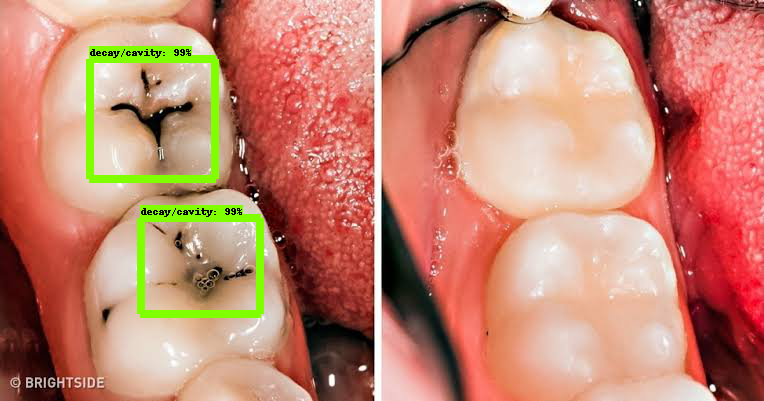

[100.]


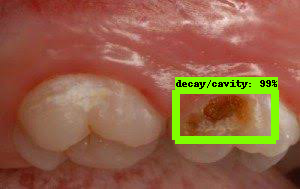

[100.]


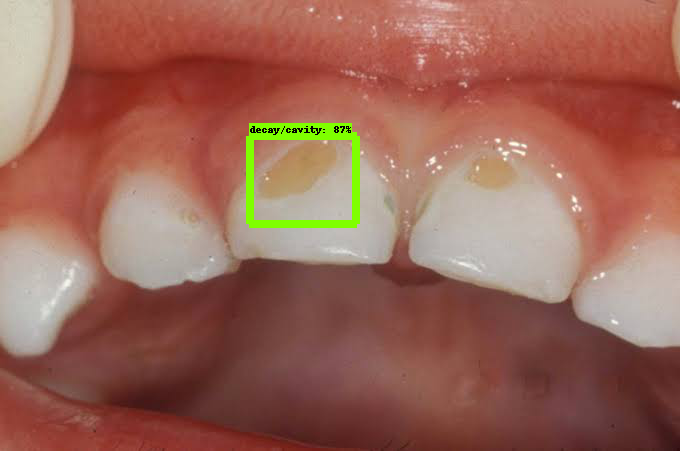

In [0]:
!cd /content/drive/My\ Drive/cav_detection_tf_obj_det_api/models/research
import os
import pathlib
import numpy as np
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util
# patch tf1 into `utils.ops`
utils_ops.tf = tf.compat.v1

# Patch the location of gfile
tf.gfile = tf.io.gfile

def load_model():
  model_dir = "/content/drive/My Drive/cav_detection_tf_obj_det_api/my_custom_detector/trained-inference-graphs/saved_model"
  model = tf.compat.v2.saved_model.load(model_dir, None)
  model = model.signatures['serving_default']

  return model


# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = '/content/drive/My Drive/cav_detection_tf_obj_det_api/my_custom_detector/training/object-detection.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('/content/drive/My Drive/cav_detection_tf_obj_det_api/my_custom_detector/test_image_dir')
TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))

detection_model = load_model()

'''
#Check the model's input signature, it expects a batch of 3-color images of type uint8:
print(detection_model.inputs)

#And retuns several outputs:
detection_model.output_dtypes
detection_model.output_shapes
'''

def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  output_dict = model(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  with tf.Session() as sess:
    print(output_dict['num_detections'].eval()) #debugging line
    num_detections = int(output_dict.pop('num_detections').eval()[0])
  
    output_dict = {key:value[0, :num_detections].eval()  #changed numpy to eval
                  for key,value in output_dict.items()}
    output_dict['num_detections'] = num_detections

    # detection_classes should be ints.
    output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
    
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict




def show_inference(model, image_path):
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = np.array(Image.open(image_path))
  # Actual detection.
  output_dict = run_inference_for_single_image(model, image_np)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)

  display(Image.fromarray(image_np))


for image_path in TEST_IMAGE_PATHS:
  show_inference(detection_model, image_path)


